In [1]:
from transformers import pipeline
from PIL import Image
from PIL import ImageDraw

c:\Users\Tharusha\AppData\Local\Programs\Python\Python311\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
checkpoint = "google/owlv2-base-patch16-ensemble"
detector = pipeline(
    model=checkpoint,
    task="zero-shot-object-detection",
    device="cuda"
)

c:\Users\Tharusha\AppData\Local\Programs\Python\Python311\Lib\site-packages\huggingface_hub\file_download.py:140: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\Tharusha\.cache\huggingface\hub\models--google--owlv2-base-patch16-ensemble. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)
Using a slow image processor as `use_fast` is unset and a slow processor 

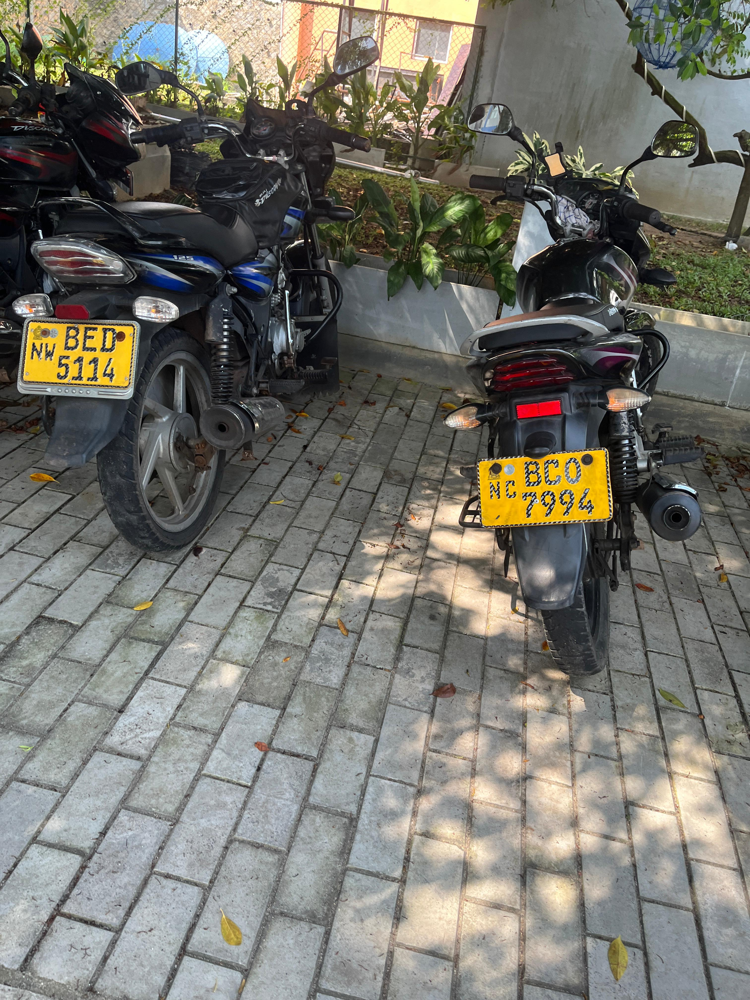

In [12]:
original_image = Image.open('Dataset/Original/32.jpg')
original_image

In [13]:
prediction = detector(
    original_image,
    candidate_labels=["license plate"],
)[0]
print(prediction)

{'score': 0.6153043508529663, 'label': 'license plate', 'box': {'xmin': 69, 'ymin': 1281, 'xmax': 565, 'ymax': 1606}}


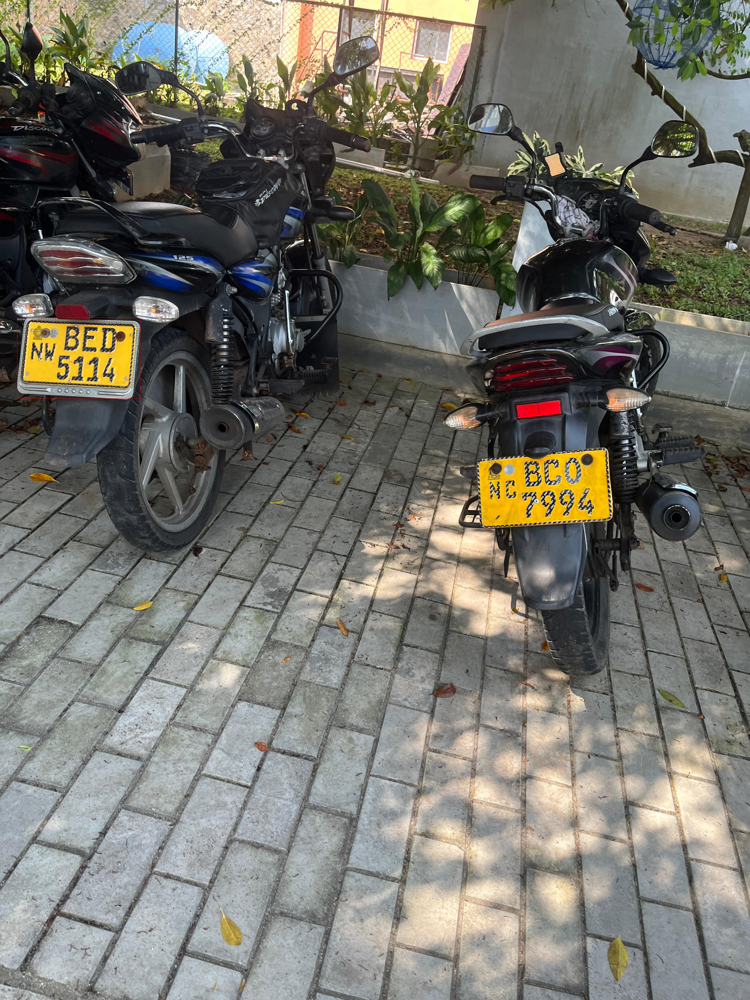

In [14]:
temporary_image = original_image.copy()
draw = ImageDraw.Draw(temporary_image)
box = prediction["box"]
label = prediction["label"]
score = prediction["score"]
xmin, ymin, xmax, ymax = box.values()
draw.rectangle((xmin, ymin, xmax, ymax), outline="red", width=1)
draw.text((xmin, ymin), f"{label}: {round(score, 2)}", fill="white")
temporary_image

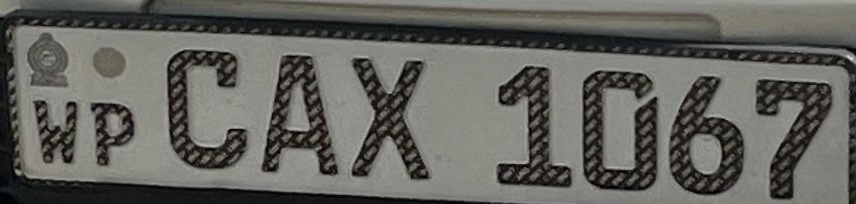

In [35]:
# cropped_image = original_image.crop(list(box.values()))
cropped_image = Image.open('Dataset/Cropped/cropped_plate_34_0_0.jpg')
cropped_image

In [36]:
from paddleocr import PaddleOCR, draw_ocr
import cv2
import numpy

In [37]:
ocr = PaddleOCR(use_angle_cls=True, lang="en")

[2025/02/14 07:35:29] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='C:\\Users\\Tharusha/.paddleocr/whl\\det\\en\\en_PP-OCRv3_det_infer', det_limit_side_len=960, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='C:\\Users\\Tharusha/.paddleocr/whl\\rec\\en\\en_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batc

In [38]:
cropped_numpy_image = numpy.array(cropped_image)
cropped_numpy_image_rgb = cropped_numpy_image[:, :, ::-1].copy()

In [39]:
result = ocr.ocr(cropped_numpy_image_rgb, cls=True)
print(f"License Plate Number: {result[0][0][1][0]}")

[2025/02/14 07:35:31] ppocr DEBUG: dt_boxes num : 2, elapsed : 0.4349546432495117
[2025/02/14 07:35:31] ppocr DEBUG: cls num  : 2, elapsed : 0.14214730262756348
[2025/02/14 07:35:31] ppocr DEBUG: rec_res num  : 2, elapsed : 0.25657057762145996
License Plate Number: CAX1067
